<a href="https://colab.research.google.com/github/BerryBeam/alert_image_identification_project/blob/main/Copy_of_ALERT_CAM_DETECT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import cv2
import random
import shutil
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator


source_folder = "alerts"
output_folder = "dataset"
train_split = 0.8
aug_per_image = 20
img_size = (224, 224)

# Augmentation generator (simulating webcam-like conditions)
augmenter = ImageDataGenerator(
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.3,
    brightness_range=(0.3, 1.2),
    shear_range=0.2,
    horizontal_flip=True,
    fill_mode="nearest"
)

# Clear and recreate output directories
if os.path.exists(output_folder):
    shutil.rmtree(output_folder)
os.makedirs(os.path.join(output_folder, "train"))
os.makedirs(os.path.join(output_folder, "val"))

# Process each image in the alerts folder
for filename in os.listdir(source_folder):
    if not filename.lower().endswith((".png", ".jpg", ".jpeg")):
        continue

    class_name = os.path.splitext(filename)[0]
    image_path = os.path.join(source_folder, filename)
    image = cv2.imread(image_path)
    image = cv2.resize(image, img_size)
    image = np.expand_dims(image, 0)

    # Generate augmented images
    aug_images = []
    for _ in range(aug_per_image):
        for batch in augmenter.flow(image, batch_size=1):
            aug_images.append(batch[0].astype(np.uint8))
            break

    # Shuffle and split into train and val sets
    random.shuffle(aug_images)
    split_index = int(train_split * len(aug_images))
    train_imgs = aug_images[:split_index]
    val_imgs = aug_images[split_index:]

    # Create class directories and save images
    train_class_dir = os.path.join(output_folder, "train", class_name)
    val_class_dir = os.path.join(output_folder, "val", class_name)
    os.makedirs(train_class_dir)
    os.makedirs(val_class_dir)

    for idx, img in enumerate(train_imgs):
        cv2.imwrite(os.path.join(train_class_dir, f"{class_name}_train_{idx}.png"), img)

    for idx, img in enumerate(val_imgs):
        cv2.imwrite(os.path.join(val_class_dir, f"{class_name}_val_{idx}.png"), img)

print("Dataset successfully created in 'dataset/' with augmentation and validation split.")

Dataset successfully created in 'dataset/' with augmentation and validation split.


In [ ]:
import os
import numpy as np
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Model
from tensorflow.keras.layers import GlobalAveragePooling2D, Dropout, Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

train_dir = 'dataset/train'
val_dir = 'dataset/val'

img_size = (224, 224)
batch_size = 32
epochs = 20
learning_rate = 1e-4

num_classes = len(next(os.walk(train_dir))[1])

train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=30,
    zoom_range=0.3,
    brightness_range=(0.3, 1.2),
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode="nearest"
)

val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

train_gen = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

val_gen = val_datagen.flow_from_directory(
    val_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

# Save label map to decode predictions later
with open("label_map.txt", "w") as f:
    for label, index in train_gen.class_indices.items():
        f.write(f"{index},{label}\n")

# Load base model with pretrained ImageNet weights
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = True

# Fine-tune only the last 30 layers
for layer in base_model.layers[:-30]:
    layer.trainable = False

# Build classifier head
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.3)(x)
output = Dense(num_classes, activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=output)

model.compile(
    optimizer=Adam(learning_rate),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

checkpoint = ModelCheckpoint('car_symbol_transfer.h5', monitor='val_accuracy', save_best_only=True, verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True)

model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=epochs,
    callbacks=[checkpoint, early_stop]
)

Found 1424 images belonging to 89 classes.
Found 356 images belonging to 89 classes.
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.0647 - loss: 4.4788
Epoch 1: val_accuracy improved from -inf to 0.25562, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 125s 3s/step - accuracy: 0.0667 - loss: 4.4674 - val_accuracy: 0.2556 - val_loss: 3.2828
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.5537 - loss: 2.3549
Epoch 2: val_accuracy improved from 0.25562 to 0.61798, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 103s 2s/step - accuracy: 0.5557 - loss: 2.3471 - val_accuracy: 0.6180 - val_loss: 1.7871
Epoch 3/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8249 - loss: 1.1106
Epoch 3: val_accuracy improved from 0.61798 to 0.79213, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 109s 2s/step - accuracy: 0.8256 - loss: 1.1068 - val_accuracy: 0.7921 - val_loss: 1.0688
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9089 - loss: 0.5403
Epoch 4: val_accuracy improved from 0.79213 to 0.84270, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 110s 2s/step - accuracy: 0.9090 - loss: 0.5398 - val_accuracy: 0.8427 - val_loss: 0.7353
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9356 - loss: 0.3810
Epoch 5: val_accuracy improved from 0.84270 to 0.90169, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 111s 2s/step - accuracy: 0.9356 - loss: 0.3805 - val_accuracy: 0.9017 - val_loss: 0.5165
Epoch 6/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9280 - loss: 0.2813
Epoch 6: val_accuracy improved from 0.90169 to 0.92978, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 109s 2s/step - accuracy: 0.9282 - loss: 0.2811 - val_accuracy: 0.9298 - val_loss: 0.3656
Epoch 7/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9549 - loss: 0.2145
Epoch 7: val_accuracy improved from 0.92978 to 0.94663, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 104s 2s/step - accuracy: 0.9548 - loss: 0.2146 - val_accuracy: 0.9466 - val_loss: 0.2905
Epoch 8/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9719 - loss: 0.1631
Epoch 8: val_accuracy improved from 0.94663 to 0.95506, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 104s 2s/step - accuracy: 0.9719 - loss: 0.1631 - val_accuracy: 0.9551 - val_loss: 0.2240
Epoch 9/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9632 - loss: 0.1638
Epoch 9: val_accuracy improved from 0.95506 to 0.96067, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 104s 2s/step - accuracy: 0.9632 - loss: 0.1638 - val_accuracy: 0.9607 - val_loss: 0.1699
Epoch 10/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9751 - loss: 0.1242
Epoch 10: val_accuracy improved from 0.96067 to 0.97753, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 141s 2s/step - accuracy: 0.9751 - loss: 0.1242 - val_accuracy: 0.9775 - val_loss: 0.1210
Epoch 11/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9722 - loss: 0.1326
Epoch 11: val_accuracy did not improve from 0.97753
45/45 ━━━━━━━━━━━━━━━━━━━━ 103s 2s/step - accuracy: 0.9723 - loss: 0.1323 - val_accuracy: 0.9719 - val_loss: 0.1138
Epoch 12/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9654 - loss: 0.1170
Epoch 12: val_accuracy did not improve from 0.97753
45/45 ━━━━━━━━━━━━━━━━━━━━ 109s 2s/step - accuracy: 0.9654 - loss: 0.1171 - val_accuracy: 0.9747 - val_loss: 0.0911
Epoch 13/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9707 - loss: 0.1113
Epoch 13: val_accuracy improved from 0.97753 to 0.98596, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 103s 2s/step - accuracy: 0.9709 - loss: 0.1110 - val_accuracy: 0.9860 - val_loss: 0.0743
Epoch 14/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9710 - loss: 0.1102
Epoch 14: val_accuracy did not improve from 0.98596
45/45 ━━━━━━━━━━━━━━━━━━━━ 103s 2s/step - accuracy: 0.9710 - loss: 0.1100 - val_accuracy: 0.9860 - val_loss: 0.0511
Epoch 15/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9784 - loss: 0.0882
Epoch 15: val_accuracy improved from 0.98596 to 1.00000, saving model to car_symbol_transfer.h5


45/45 ━━━━━━━━━━━━━━━━━━━━ 103s 2s/step - accuracy: 0.9784 - loss: 0.0883 - val_accuracy: 1.0000 - val_loss: 0.0392
Epoch 16/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9808 - loss: 0.0715
Epoch 16: val_accuracy did not improve from 1.00000
45/45 ━━━━━━━━━━━━━━━━━━━━ 102s 2s/step - accuracy: 0.9808 - loss: 0.0717 - val_accuracy: 0.9916 - val_loss: 0.0369
Epoch 17/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9787 - loss: 0.0733
Epoch 17: val_accuracy did not improve from 1.00000
45/45 ━━━━━━━━━━━━━━━━━━━━ 103s 2s/step - accuracy: 0.9788 - loss: 0.0733 - val_accuracy: 0.9888 - val_loss: 0.0318
Epoch 18/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9847 - loss: 0.0630
Epoch 18: val_accuracy did not improve from 1.00000
45/45 ━━━━━━━━━━━━━━━━━━━━ 102s 2s/step - accuracy: 0.9846 - loss: 0.0631 - val_accuracy: 0.9860 - val_loss: 0.0474
Epoch 19/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9739 - loss: 0.0925
Epoch 19: val_accuracy did not improve from 


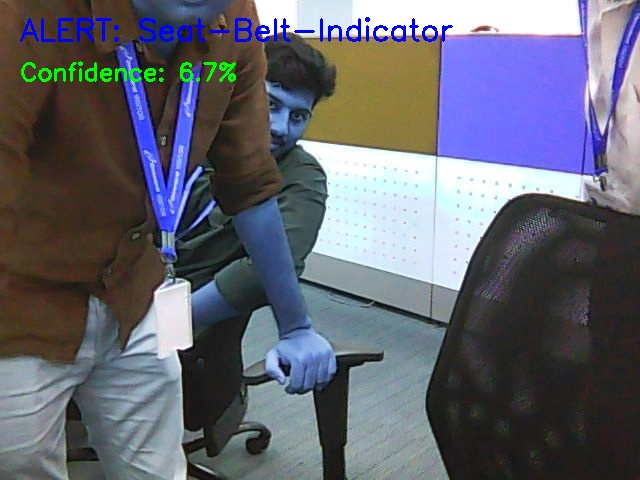


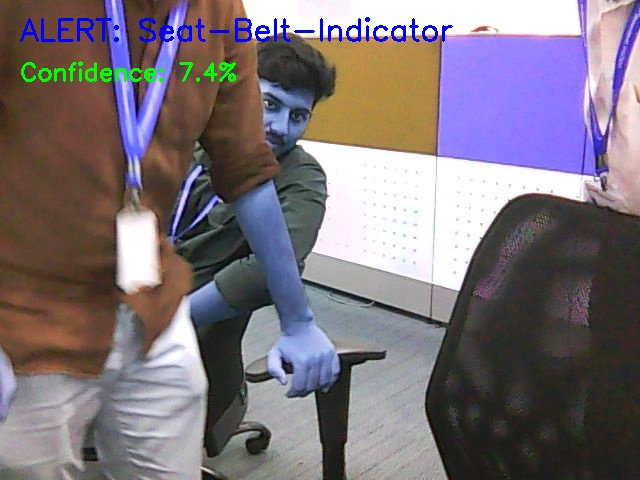


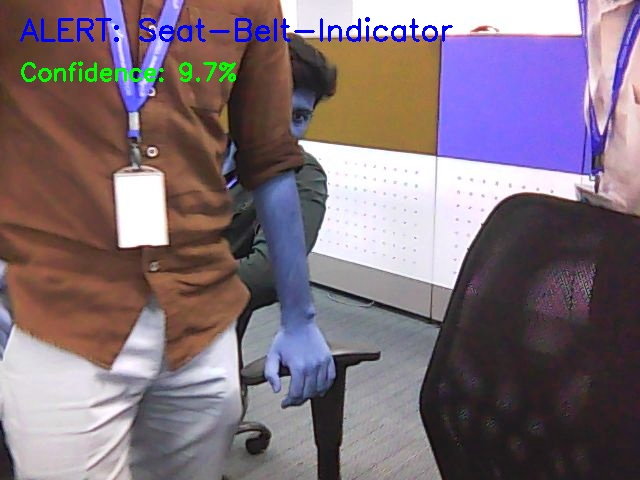


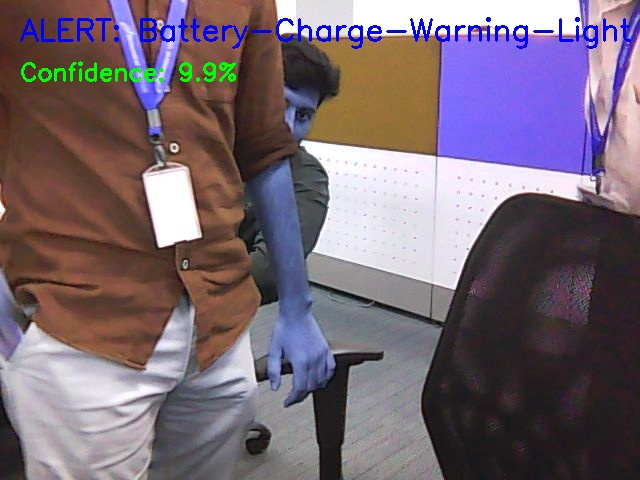


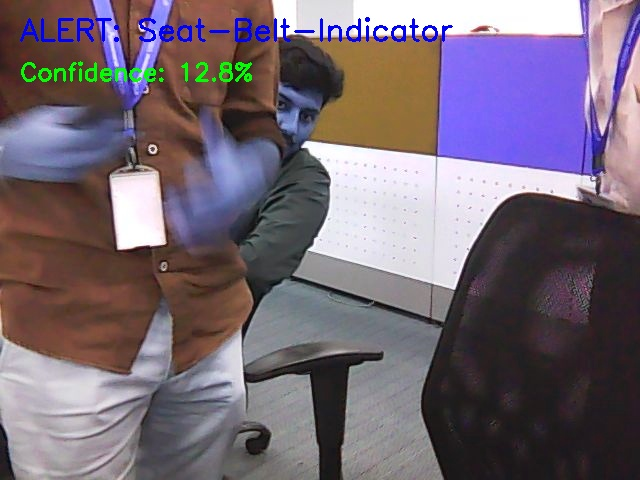


...


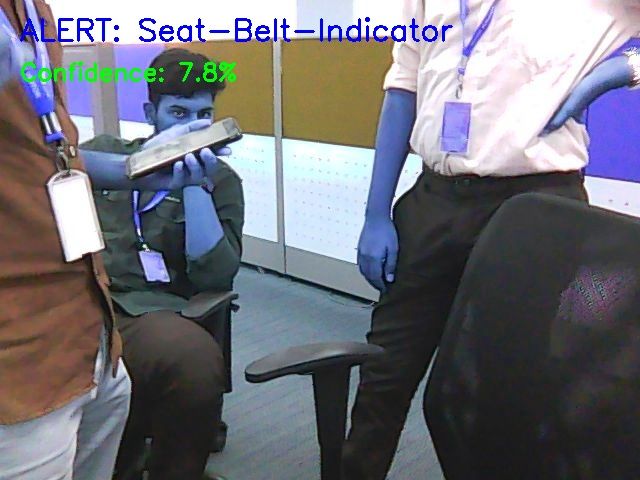


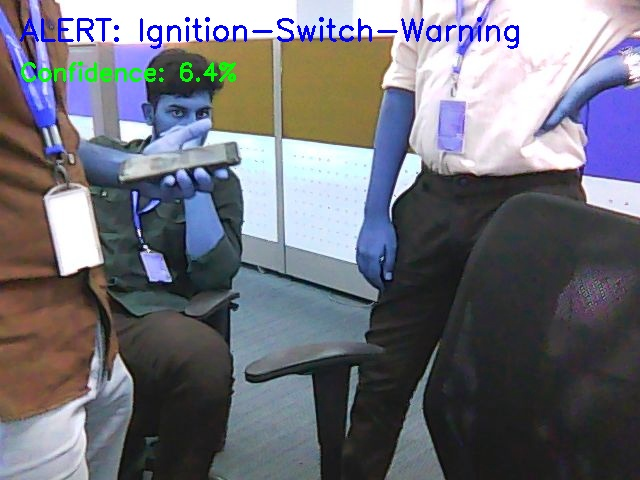


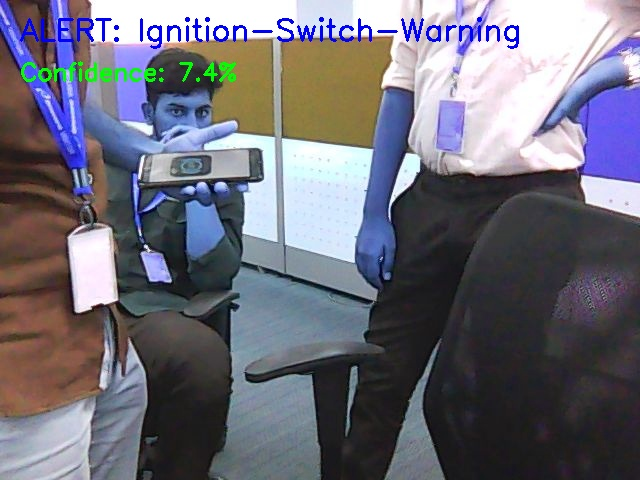


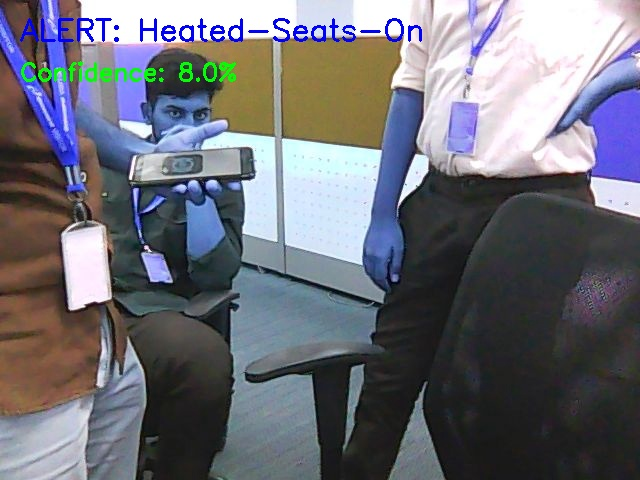


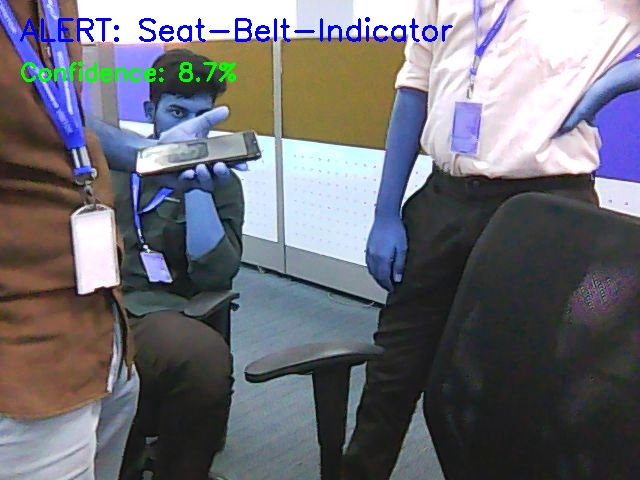

Stopped


<IPython.core.display.Javascript object>

In [ ]:
from google.colab.output import eval_js
from IPython.display import display, Javascript, HTML
from base64 import b64decode, b64encode
import cv2
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array

# Load model and labels
model = load_model('car_symbol_transfer.h5')
with open('label_map.txt') as f:
    class_names = [line.strip().split(',')[1] for line in f]

# Webcam setup with proper color handling
display(HTML('''
<div id="video-container">
  <video id="webcam" width="640" height="480" autoplay playsinline style="display:none;"></video>
  <canvas id="canvas" width="640" height="480" style="display:none;"></canvas>
  <img id="output" width="640" height="480">
</div>
<script>
const video = document.getElementById('webcam');
const canvas = document.getElementById('canvas');
const ctx = canvas.getContext('2d');

async function startWebcam() {
  const stream = await navigator.mediaDevices.getUserMedia({video: true});
  video.srcObject = stream;
  await video.play();
  return true;
}

function captureFrame() {
  ctx.drawImage(video, 0, 0, 640, 480);
  return canvas.toDataURL('image/jpeg', 0.8);
}
</script>
'''))

# Initialize webcam
eval_js('startWebcam()')

# Main loop
try:
    while True:
        # Get frame
        data = eval_js('captureFrame()')
        img_bytes = b64decode(data.split(',')[1])
        frame = cv2.imdecode(np.frombuffer(img_bytes, dtype=np.uint8), cv2.IMREAD_COLOR)

        # Convert BGR to RGB
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        # Process and predict
        img = cv2.resize(frame_rgb, (224, 224))
        img = preprocess_input(img_to_array(img))
        preds = model.predict(np.expand_dims(img, axis=0), verbose=0)[0]
        label = class_names[np.argmax(preds)]
        conf = np.max(preds)*100

        # Draw on frame (using RGB colors)
        cv2.putText(frame_rgb, f"ALERT: {label}", (20, 40),
                   cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2)
        cv2.putText(frame_rgb, f"Confidence: {conf:.1f}%", (20, 80),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0,255,0), 2)

        # Convert to base64 and display
        _, jpeg = cv2.imencode('.jpg', frame_rgb)
        display(HTML(f'''
        <script>
        document.getElementById("output").src =
          'data:image/jpeg;base64,{b64encode(jpeg).decode()}';
        </script>
        '''))

except KeyboardInterrupt:
    print("Stopped")
finally:
    # Cleanup
    display(Javascript('''
    const video = document.getElementById('webcam');
    if (video.srcObject) {
        video.srcObject.getTracks().forEach(track => track.stop());
    }
    '''))

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (GlobalAveragePooling2D, Dropout,
                                   Dense, BatchNormalization)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import (ModelCheckpoint, EarlyStopping,
                                      ReduceLROnPlateau, TensorBoard)
from tensorflow.keras.regularizers import l2

# Data parameters
train_dir = 'dataset/train'
val_dir = 'dataset/val'
img_size = (224, 224)
batch_size = 32
epochs = 30

# Data augmentation
train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=40,
    zoom_range=0.3,
    brightness_range=(0.2, 1.3),
    width_shift_range=0.25,
    height_shift_range=0.25,
    shear_range=0.2,
    horizontal_flip=True,
    vertical_flip=True,
    fill_mode="nearest"
)

val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Data generators
train_gen = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True
)

val_gen = val_datagen.flow_from_directory(
    val_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Save label map
with open("label_map.txt", "w") as f:
    for label, index in train_gen.class_indices.items():
        f.write(f"{index},{label}\n")

# Load base model
base_model = MobileNetV2(weights='imagenet',
                        include_top=False,
                        input_shape=(224, 224, 3))

# Fine-tuning
base_model.trainable = True
for layer in base_model.layers[:-50]:
    layer.trainable = False

# Enhanced classifier
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu', kernel_regularizer=l2(0.001))(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='relu', kernel_regularizer=l2(0.001))(x)
x = BatchNormalization()(x)
x = Dropout(0.3)(x)
output = Dense(train_gen.num_classes,
              activation='softmax',
              kernel_regularizer=l2(0.001))(x)

model = Model(inputs=base_model.input, outputs=output)

# Optimizer with lower initial learning rate
optimizer = Adam(learning_rate=1e-4)

# Fixed class weights calculation
class_counts = np.bincount(train_gen.classes)
class_weights = {}
for i in range(len(class_counts)):
    if class_counts[i] > 0:  # Prevent division by zero
        class_weights[i] = (1./class_counts[i]) * train_gen.num_classes / sum(1./c for c in class_counts if c > 0)

# Compile the model (THIS WAS MISSING)
model.compile(
    optimizer=optimizer,
    loss='categorical_crossentropy',
    metrics=['accuracy',
            tf.keras.metrics.Precision(name='precision'),
            tf.keras.metrics.Recall(name='recall')]
)

# Enhanced callbacks
callbacks = [
    ModelCheckpoint('best_model.h5',
                  monitor='val_accuracy',
                  save_best_only=True,
                  mode='max'),
    EarlyStopping(monitor='val_accuracy',
                 patience=15,
                 min_delta=0.001,
                 mode='max',
                 restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss',
                     factor=0.2,
                     patience=5,
                     min_lr=1e-6,
                     verbose=1),
    TensorBoard(log_dir='./logs')
]

# Training
history = model.fit(
    train_gen,
    steps_per_epoch=len(train_gen),
    validation_data=val_gen,
    validation_steps=len(val_gen),
    epochs=epochs,
    callbacks=callbacks,
    class_weight=class_weights,
    verbose=1
)

Found 1424 images belonging to 89 classes.
Found 356 images belonging to 89 classes.
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.0257 - loss: 6.4486 - precision: 0.0000e+00 - recall: 0.0000e+00

45/45 ━━━━━━━━━━━━━━━━━━━━ 155s 3s/step - accuracy: 0.0258 - loss: 6.4429 - precision: 0.0000e+00 - recall: 0.0000e+00 - val_accuracy: 0.0393 - val_loss: 5.5354 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 2/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.0919 - loss: 5.4032 - precision: 0.3835 - recall: 0.0037

45/45 ━━━━━━━━━━━━━━━━━━━━ 141s 3s/step - accuracy: 0.0926 - loss: 5.3988 - precision: 0.3885 - recall: 0.0038 - val_accuracy: 0.1320 - val_loss: 5.1373 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 3/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.2260 - loss: 4.5794 - precision: 0.7686 - recall: 0.0280

45/45 ━━━━━━━━━━━━━━━━━━━━ 141s 3s/step - accuracy: 0.2264 - loss: 4.5767 - precision: 0.7687 - recall: 0.0283 - val_accuracy: 0.2781 - val_loss: 4.6362 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 4/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.3603 - loss: 4.0022 - precision: 0.7665 - recall: 0.0638

45/45 ━━━━━━━━━━━━━━━━━━━━ 144s 3s/step - accuracy: 0.3607 - loss: 3.9985 - precision: 0.7665 - recall: 0.0643 - val_accuracy: 0.4494 - val_loss: 4.0504 - val_precision: 1.0000 - val_recall: 0.0197 - learning_rate: 1.0000e-04
Epoch 5/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.4712 - loss: 3.3990 - precision: 0.8810 - recall: 0.1634

45/45 ━━━━━━━━━━━━━━━━━━━━ 141s 3s/step - accuracy: 0.4720 - loss: 3.3960 - precision: 0.8808 - recall: 0.1637 - val_accuracy: 0.5506 - val_loss: 3.4683 - val_precision: 0.9643 - val_recall: 0.0758 - learning_rate: 1.0000e-04
Epoch 6/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.5967 - loss: 2.9663 - precision: 0.9284 - recall: 0.2146

45/45 ━━━━━━━━━━━━━━━━━━━━ 148s 3s/step - accuracy: 0.5969 - loss: 2.9653 - precision: 0.9280 - recall: 0.2153 - val_accuracy: 0.6489 - val_loss: 2.9798 - val_precision: 0.9091 - val_recall: 0.1966 - learning_rate: 1.0000e-04
Epoch 7/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6909 - loss: 2.6538 - precision: 0.9038 - recall: 0.3181

45/45 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.6912 - loss: 2.6527 - precision: 0.9041 - recall: 0.3186 - val_accuracy: 0.7472 - val_loss: 2.6311 - val_precision: 0.9138 - val_recall: 0.2978 - learning_rate: 1.0000e-04
Epoch 8/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7137 - loss: 2.4728 - precision: 0.9222 - recall: 0.4100

45/45 ━━━━━━━━━━━━━━━━━━━━ 141s 3s/step - accuracy: 0.7138 - loss: 2.4720 - precision: 0.9220 - recall: 0.4100 - val_accuracy: 0.7865 - val_loss: 2.3742 - val_precision: 0.9128 - val_recall: 0.3820 - learning_rate: 1.0000e-04
Epoch 9/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7729 - loss: 2.2397 - precision: 0.9278 - recall: 0.4845

45/45 ━━━━━━━━━━━━━━━━━━━━ 132s 3s/step - accuracy: 0.7729 - loss: 2.2395 - precision: 0.9276 - recall: 0.4844 - val_accuracy: 0.8287 - val_loss: 2.1491 - val_precision: 0.9282 - val_recall: 0.4719 - learning_rate: 1.0000e-04
Epoch 10/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8174 - loss: 2.0461 - precision: 0.9555 - recall: 0.5580

45/45 ━━━━━━━━━━━━━━━━━━━━ 132s 3s/step - accuracy: 0.8177 - loss: 2.0456 - precision: 0.9552 - recall: 0.5585 - val_accuracy: 0.8455 - val_loss: 2.0078 - val_precision: 0.9182 - val_recall: 0.5674 - learning_rate: 1.0000e-04
Epoch 11/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8564 - loss: 1.9633 - precision: 0.9533 - recall: 0.6073

45/45 ━━━━━━━━━━━━━━━━━━━━ 131s 3s/step - accuracy: 0.8562 - loss: 1.9632 - precision: 0.9531 - recall: 0.6075 - val_accuracy: 0.8708 - val_loss: 1.8621 - val_precision: 0.9286 - val_recall: 0.6573 - learning_rate: 1.0000e-04
Epoch 12/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8283 - loss: 1.9254 - precision: 0.9456 - recall: 0.6502

45/45 ━━━━━━━━━━━━━━━━━━━━ 143s 3s/step - accuracy: 0.8285 - loss: 1.9247 - precision: 0.9455 - recall: 0.6504 - val_accuracy: 0.8820 - val_loss: 1.7485 - val_precision: 0.9466 - val_recall: 0.7472 - learning_rate: 1.0000e-04
Epoch 13/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8668 - loss: 1.8561 - precision: 0.9304 - recall: 0.6651

45/45 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.8667 - loss: 1.8556 - precision: 0.9304 - recall: 0.6656 - val_accuracy: 0.9101 - val_loss: 1.6637 - val_precision: 0.9544 - val_recall: 0.7640 - learning_rate: 1.0000e-04
Epoch 14/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.8738 - loss: 1.7630 - precision: 0.9388 - recall: 0.7315 - val_accuracy: 0.8989 - val_loss: 1.6151 - val_precision: 0.9400 - val_recall: 0.7921 - learning_rate: 1.0000e-04
Epoch 15/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8914 - loss: 1.7037 - precision: 0.9477 - recall: 0.7515

45/45 ━━━━━━━━━━━━━━━━━━━━ 141s 3s/step - accuracy: 0.8913 - loss: 1.7037 - precision: 0.9475 - recall: 0.7515 - val_accuracy: 0.9157 - val_loss: 1.5329 - val_precision: 0.9586 - val_recall: 0.8455 - learning_rate: 1.0000e-04
Epoch 16/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9076 - loss: 1.6290 - precision: 0.9481 - recall: 0.8040

45/45 ━━━━━━━━━━━━━━━━━━━━ 131s 3s/step - accuracy: 0.9075 - loss: 1.6291 - precision: 0.9481 - recall: 0.8040 - val_accuracy: 0.9354 - val_loss: 1.4709 - val_precision: 0.9606 - val_recall: 0.8904 - learning_rate: 1.0000e-04
Epoch 17/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 139s 3s/step - accuracy: 0.8972 - loss: 1.6462 - precision: 0.9554 - recall: 0.7765 - val_accuracy: 0.9354 - val_loss: 1.4116 - val_precision: 0.9610 - val_recall: 0.8989 - learning_rate: 1.0000e-04
Epoch 18/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9025 - loss: 1.6309 - precision: 0.9408 - recall: 0.7820

45/45 ━━━━━━━━━━━━━━━━━━━━ 131s 3s/step - accuracy: 0.9024 - loss: 1.6309 - precision: 0.9408 - recall: 0.7820 - val_accuracy: 0.9438 - val_loss: 1.3928 - val_precision: 0.9527 - val_recall: 0.9045 - learning_rate: 1.0000e-04
Epoch 19/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9149 - loss: 1.5850 - precision: 0.9629 - recall: 0.8245

45/45 ━━━━━━━━━━━━━━━━━━━━ 131s 3s/step - accuracy: 0.9149 - loss: 1.5846 - precision: 0.9628 - recall: 0.8246 - val_accuracy: 0.9494 - val_loss: 1.3488 - val_precision: 0.9563 - val_recall: 0.9213 - learning_rate: 1.0000e-04
Epoch 20/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 144s 3s/step - accuracy: 0.9047 - loss: 1.5652 - precision: 0.9408 - recall: 0.8182 - val_accuracy: 0.9494 - val_loss: 1.3331 - val_precision: 0.9597 - val_recall: 0.9354 - learning_rate: 1.0000e-04
Epoch 21/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9241 - loss: 1.5193 - precision: 0.9622 - recall: 0.8582

45/45 ━━━━━━━━━━━━━━━━━━━━ 133s 3s/step - accuracy: 0.9240 - loss: 1.5195 - precision: 0.9620 - recall: 0.8579 - val_accuracy: 0.9579 - val_loss: 1.3027 - val_precision: 0.9657 - val_recall: 0.9494 - learning_rate: 1.0000e-04
Epoch 22/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 132s 3s/step - accuracy: 0.9136 - loss: 1.5098 - precision: 0.9621 - recall: 0.8508 - val_accuracy: 0.9522 - val_loss: 1.2872 - val_precision: 0.9602 - val_recall: 0.9494 - learning_rate: 1.0000e-04
Epoch 23/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 142s 3s/step - accuracy: 0.9298 - loss: 1.4723 - precision: 0.9621 - recall: 0.8789 - val_accuracy: 0.9579 - val_loss: 1.2790 - val_precision: 0.9576 - val_recall: 0.9522 - learning_rate: 1.0000e-04
Epoch 24/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9381 - loss: 1.4432 - precision: 0.9636 - recall: 0.8861

45/45 ━━━━━━━━━━━━━━━━━━━━ 142s 3s/step - accuracy: 0.9380 - loss: 1.4433 - precision: 0.9633 - recall: 0.8859 - val_accuracy: 0.9635 - val_loss: 1.2590 - val_precision: 0.9688 - val_recall: 0.9607 - learning_rate: 1.0000e-04
Epoch 25/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9249 - loss: 1.4660 - precision: 0.9527 - recall: 0.8617

45/45 ━━━━━━━━━━━━━━━━━━━━ 140s 3s/step - accuracy: 0.9250 - loss: 1.4658 - precision: 0.9527 - recall: 0.8617 - val_accuracy: 0.9719 - val_loss: 1.2543 - val_precision: 0.9744 - val_recall: 0.9635 - learning_rate: 1.0000e-04
Epoch 26/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 132s 3s/step - accuracy: 0.9448 - loss: 1.4142 - precision: 0.9703 - recall: 0.9048 - val_accuracy: 0.9635 - val_loss: 1.2389 - val_precision: 0.9634 - val_recall: 0.9607 - learning_rate: 1.0000e-04
Epoch 27/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9167 - loss: 1.4378 - precision: 0.9417 - recall: 0.8747

45/45 ━━━━━━━━━━━━━━━━━━━━ 143s 3s/step - accuracy: 0.9168 - loss: 1.4377 - precision: 0.9418 - recall: 0.8748 - val_accuracy: 0.9747 - val_loss: 1.2278 - val_precision: 0.9802 - val_recall: 0.9719 - learning_rate: 1.0000e-04
Epoch 28/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 135s 3s/step - accuracy: 0.9369 - loss: 1.3897 - precision: 0.9566 - recall: 0.9067 - val_accuracy: 0.9635 - val_loss: 1.2402 - val_precision: 0.9661 - val_recall: 0.9607 - learning_rate: 1.0000e-04
Epoch 29/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 139s 3s/step - accuracy: 0.9565 - loss: 1.3753 - precision: 0.9717 - recall: 0.9157 - val_accuracy: 0.9663 - val_loss: 1.2307 - val_precision: 0.9663 - val_recall: 0.9663 - learning_rate: 1.0000e-04
Epoch 30/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 133s 3s/step - accuracy: 0.9409 - loss: 1.3864 - precision: 0.9585 - recall: 0.9089 - val_accuracy: 0.9719 - val_loss: 1.2140 - val_precision: 0.9746 - val_recall: 0.9719 - learning_rate: 1.0000e-04


✓ System verification passed



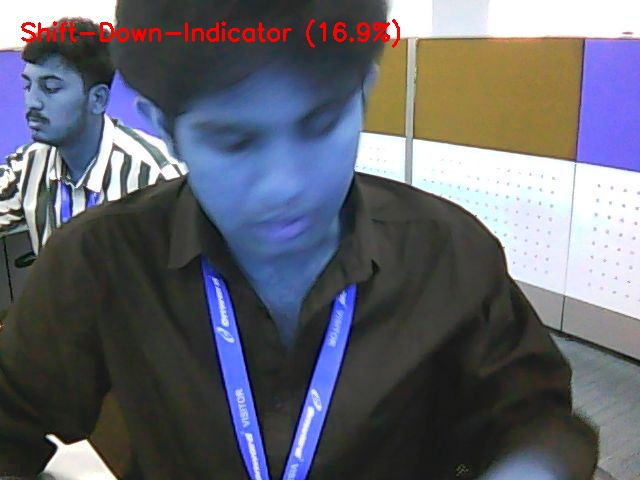


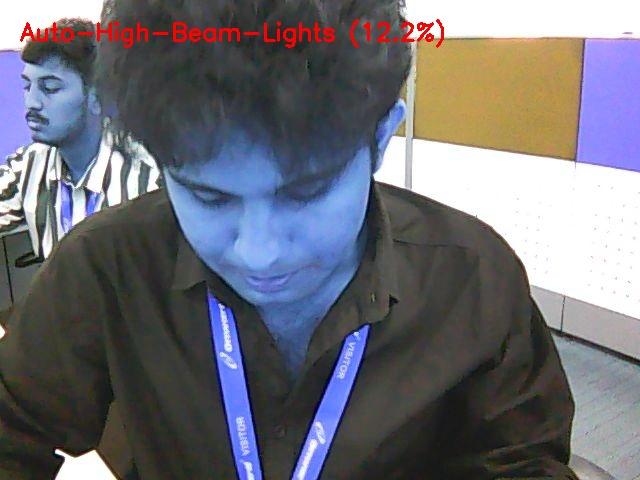


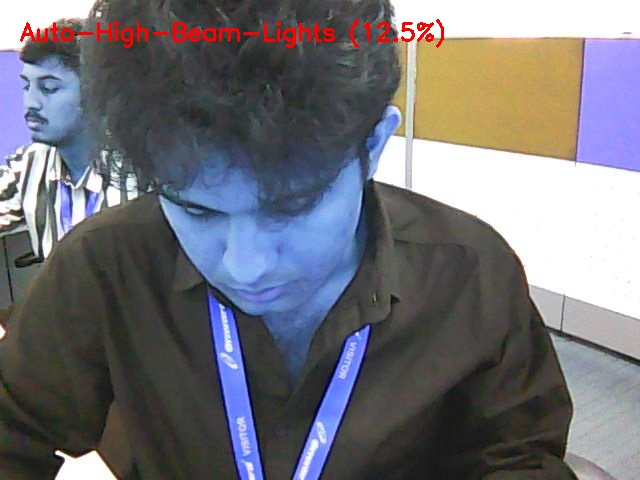


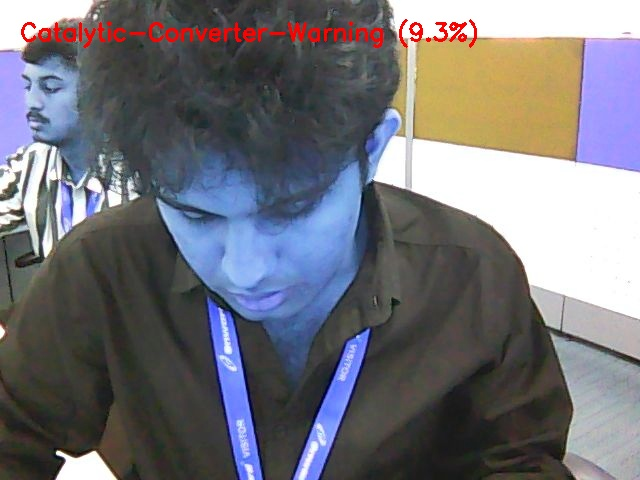


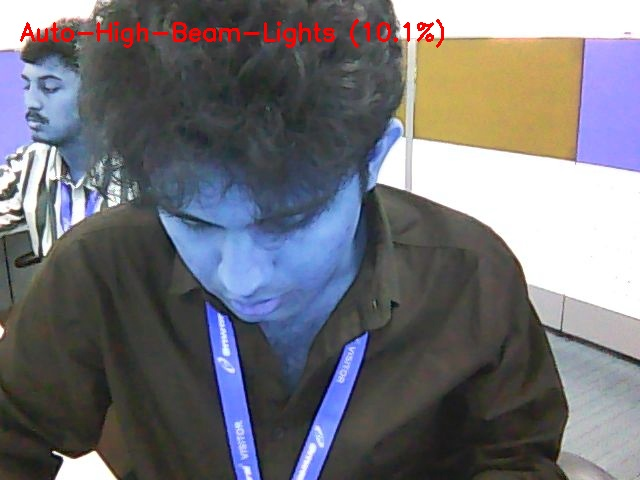


...


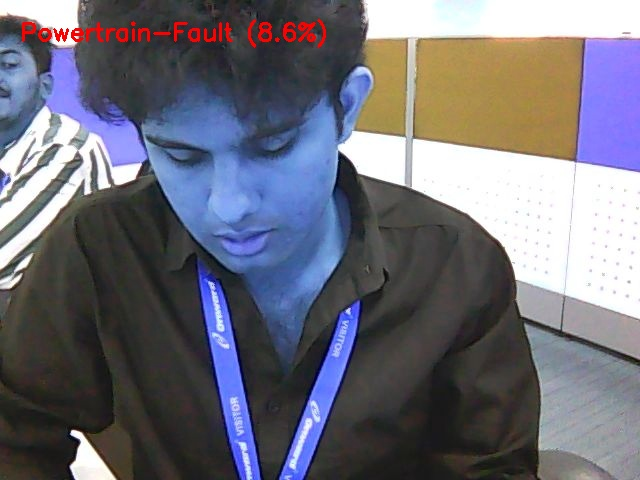


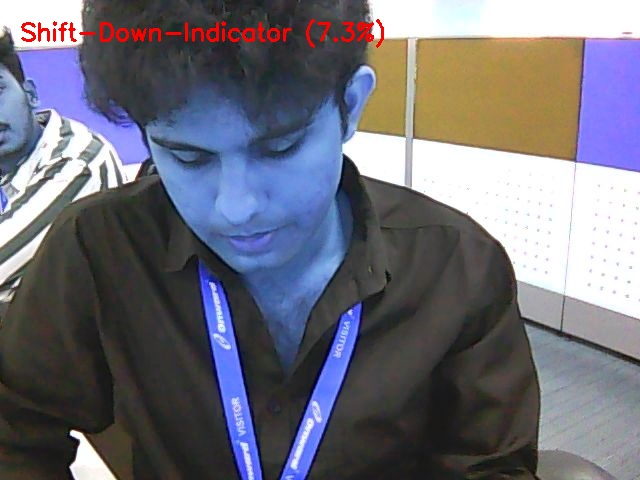


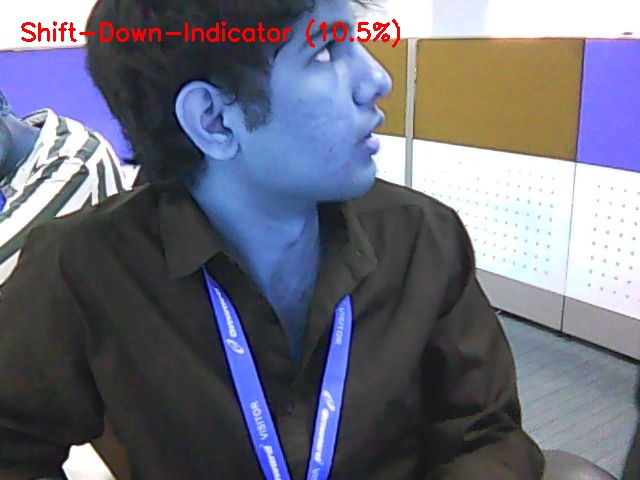


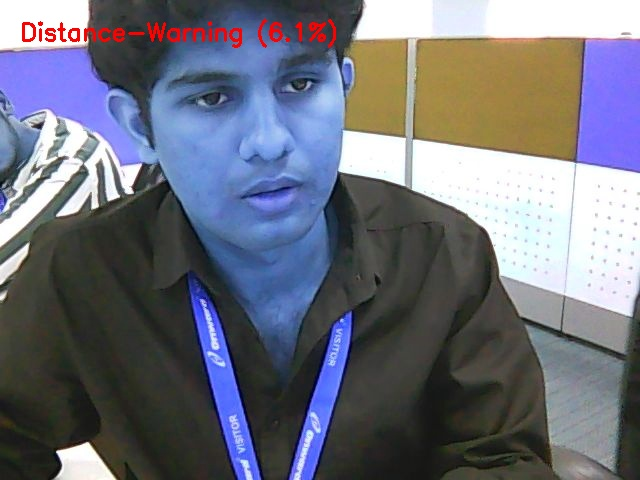


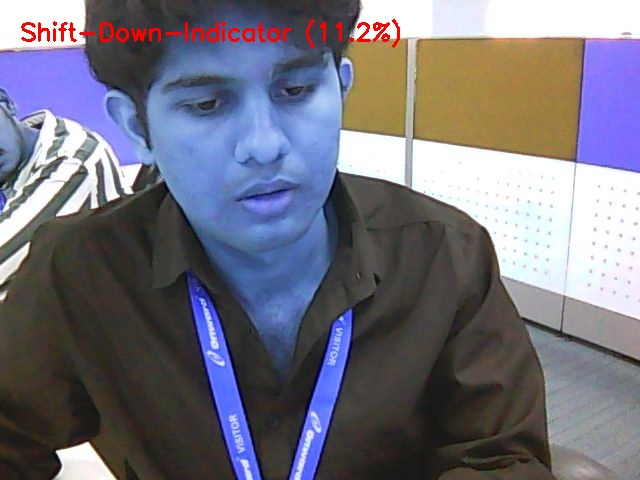


🛑 Graceful shutdown initiated

=== FINAL ALERT LOG ===


,timestamp,alert_type,confidence,duration,2025-06-24 06:49:31,Service-Engine-Soon,0.083,2.88
0,2025-06-24 07:00:24,Particle-Filter-Warning,0.070,2.88,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,2025-06-24 06:50:11,Anti-lock-Braking-System-ABS,0.160,10.14
1,NaN,NaN,NaN,NaN,2025-06-24 06:50:40,Automatic-Shift-Lock-Symbol,0.094,5.00
2,NaN,NaN,NaN,NaN,2025-06-24 06:51:01,Lambda-Warning-Light,0.110,4.05
3,NaN,NaN,NaN,NaN,2025-06-24 06:58:48,Service-Engine-Soon,0.181,4.71
4,NaN,NaN,NaN,NaN,2025-06-24 06:59:04,Automatic-Shift-Lock-Symbol,0.123,4.39
5,NaN,NaN,NaN,NaN,2025-06-24 07:00:24,Particle-Filter-Warning,0.070,2.88


✓ Logs saved to 'alert_logs_verified.csv'


In [ ]:
from IPython.display import display, Javascript, HTML
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import pandas as pd
import time
from datetime import datetime
import traceback

# ========== SAFETY CHECKS ==========
def verify_system():
    """Validate all critical components before starting"""
    checks = {
        'model_loaded': 'model' in globals() and hasattr(model, 'predict'),
        'class_names_exists': 'class_names' in globals() and len(class_names) > 0,
        'preprocess_input': 'preprocess_input' in globals(),
        'img_to_array': 'img_to_array' in globals()
    }

    if not all(checks.values()):
        missing = [k for k,v in checks.items() if not v]
        raise RuntimeError(f"Critical missing components: {missing}")

# ========== ARMORED ALERT LOGGER ==========
class SafetyAlertLogger:
    def __init__(self):
        self.log = pd.DataFrame(columns=['timestamp', 'alert_type', 'confidence', 'duration'])
        self.current_alert = None
        self.alert_start_time = None
        self.alert_buffer = []
        self._backup_file = '/tmp/alert_backup.csv'

    def _atomic_write(self, data):
        """Crash-resistant file writing"""
        try:
            with open(self._backup_file, 'a') as f:
                f.write(','.join(map(str, data)) + '\n')
        except Exception as e:
            print(f"BACKUP FAILED: {str(e)}")

    def update(self, alert_type, confidence):
        try:
            timestamp = datetime.now()

            # Validation checks
            if not isinstance(confidence, (float, np.floating)):
                raise ValueError(f"Invalid confidence: {confidence}")
            if not isinstance(alert_type, str):
                alert_type = str(alert_type)

            # Buffer management
            self.alert_buffer.append((alert_type, min(max(confidence, 0.0), 1.0)))  # Clamped confidence
            if len(self.alert_buffer) > 5:
                self.alert_buffer.pop(0)

            # Consensus logic
            if self.alert_buffer:
                alerts = [x[0] for x in self.alert_buffer]
                most_common = max(set(alerts), key=alerts.count, default=None)
                conf_values = [x[1] for x in self.alert_buffer if x[0] == most_common]
                avg_conf = np.mean(conf_values) if conf_values else 0.0
            else:
                most_common, avg_conf = None, 0.0

            # State transition
            if most_common != self.current_alert:
                # End previous alert
                if self.current_alert and self.alert_start_time:
                    duration = (timestamp - self.alert_start_time).total_seconds()
                    if duration >= 1.0:
                        log_entry = [
                            self.alert_start_time.strftime('%Y-%m-%d %H:%M:%S'),
                            self.current_alert,
                            f"{avg_conf:.3f}",
                            f"{duration:.2f}"
                        ]
                        self.log = pd.concat([self.log, pd.DataFrame([dict(zip(
                            ['timestamp', 'alert_type', 'confidence', 'duration'],
                            log_entry
                        ))])], ignore_index=True)
                        self._atomic_write(log_entry)
                        display(HTML(
                            f"<div style='color:green;font-weight:bold'>"
                            f"✔ LOGGED: {self.current_alert} ({duration:.1f}s, {avg_conf*100:.1f}%)"
                            f"</div>"
                        ))

                # Start new alert
                self.current_alert = most_common if avg_conf > 0.35 else None
                self.alert_start_time = timestamp if self.current_alert else None

        except Exception as e:
            print(f"⚠ LOGGER ERROR: {str(e)}")
            traceback.print_exc()

    def get_logs(self):
        """Returns verified logs"""
        try:
            # Merge with backup if exists
            try:
                backup = pd.read_csv(self._backup_file)
                self.log = pd.concat([self.log, backup]).drop_duplicates()
            except FileNotFoundError:
                pass

            return self.log.sort_values('timestamp', ascending=False)
        except Exception as e:
            print(f"LOG RETRIEVAL ERROR: {str(e)}")
            return pd.DataFrame()

# ========== FAILSAFE CAMERA HANDLER ==========
class FailsafeCamera:
    def __init__(self):
        self._setup_display()
        self.max_retries = 3
        self.retry_delay = 2

    def _setup_display(self):
        display(HTML('''
        <div id="camera-container">
          <video id="webcam" width="640" height="480" autoplay playsinline style="display:none;"></video>
          <canvas id="canvas" width="640" height="480" style="display:none;"></canvas>
          <img id="output" width="640" height="480">
          <div id="status" style="margin:10px;padding:10px;background:#111;color:#eee;font-family:monospace"></div>
        </div>
        '''))

    def _js(self, code):
        """Safe JS execution with retries"""
        for i in range(self.max_retries):
            try:
                return eval_js(code)
            except Exception as e:
                if i == self.max_retries - 1:
                    raise
                time.sleep(self.retry_delay)

    def start(self):
        try:
            return self._js('''
            (async function() {
                const video = document.getElementById('webcam');
                try {
                    const stream = await navigator.mediaDevices.getUserMedia({video: true});
                    video.srcObject = stream;
                    await video.play();
                    return true;
                } catch (e) {
                    console.error("Camera error:", e);
                    return false;
                }
            })()
            ''')
        except Exception as e:
            raise RuntimeError(f"Camera initialization failed: {str(e)}")

    def capture_frame(self):
        try:
            frame_data = self._js('''
            (function() {
                const canvas = document.getElementById('canvas');
                const ctx = canvas.getContext('2d');
                ctx.drawImage(document.getElementById('webcam'), 0, 0, 640, 480);
                return canvas.toDataURL('image/jpeg', 0.8);
            })()
            ''')
            return frame_data
        except Exception as e:
            raise RuntimeError(f"Frame capture failed: {str(e)}")

# ========== MAIN EXECUTION ==========
try:
    # Pre-flight checks
    verify_system()
    print("✓ System verification passed")

    # Initialize components
    logger = SafetyAlertLogger()
    camera = FailsafeCamera()

    # Start camera with status monitoring
    if not camera.start():
        raise RuntimeError("Failed to initialize camera")

    display(HTML('<div id="alert-display" style="margin-top:10px;padding:10px;background:#f5f5f5;border:1px solid #ddd"></div>'))

    # Main processing loop
    last_update = time.time()
    while True:
        try:
            # Frame capture
            frame_data = camera.capture_frame()

            # Decode and validate
            img_bytes = b64decode(frame_data.split(',')[1])
            frame = cv2.imdecode(np.frombuffer(img_bytes, dtype=np.uint8), cv2.IMREAD_COLOR)
            if frame is None:
                raise ValueError("Empty frame captured")

            # Prediction
            img = cv2.resize(frame.copy(), (224, 224))
            img = preprocess_input(img_to_array(img))
            preds = model.predict(np.expand_dims(img, axis=0), verbose=0)[0]
            class_idx = np.argmax(preds)
            alert_type = class_names[class_idx]
            confidence = float(preds[class_idx])

            # Logging
            logger.update(alert_type, confidence)

            # Visual feedback
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            status_color = (0, 255, 0) if confidence > 0.6 else (0, 165, 255) if confidence > 0.4 else (0, 0, 255)
            cv2.putText(frame, f"{alert_type} ({confidence*100:.1f}%)", (20, 40),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.8, status_color, 2)

            # Update display (throttled to 2 FPS)
            if time.time() - last_update > 0.5:
                _, jpeg = cv2.imencode('.jpg', frame)
                current_alert = logger.current_alert if logger.current_alert else "None"
                display(HTML(f'''
                <script>
                document.getElementById("output").src = 'data:image/jpeg;base64,{b64encode(jpeg).decode()}';
                document.getElementById("alert-display").innerHTML =
                    'LAST ALERT: <b>{current_alert}</b> | ' +
                    'CONFIDENCE: <b>{(confidence*100):.1f}%</b> | ' +
                    'LOGGED: <b>{logger.log.shape[0]}</b> | ' +
                    'STATUS: <span style="color:green">ACTIVE</span>';
                </script>
                '''))
                last_update = time.time()

            time.sleep(0.1)

        except KeyboardInterrupt:
            print("\n🛑 Graceful shutdown initiated")
            break
        except Exception as e:
            print(f"⚠ Processing error: {str(e)}")
            traceback.print_exc()
            time.sleep(1)  # Prevent tight failure loops

except Exception as e:
    print(f"🚨 CRITICAL FAILURE: {str(e)}")
    traceback.print_exc()
finally:
    # Emergency cleanup
    try:
        camera._js('''
        const video = document.getElementById('webcam');
        if (video.srcObject) {
            video.srcObject.getTracks().forEach(track => track.stop());
        }
        ''')
    except:
        pass

    # Final log dump
    print("\n=== FINAL ALERT LOG ===")
    logs = logger.get_logs()
    display(logs)

    try:
        logs.to_csv('alert_logs_verified.csv', index=False)
        print("✓ Logs saved to 'alert_logs_verified.csv'")
    except Exception as e:
        print(f"⚠ Failed to save logs: {str(e)}")
        print("⚠ Backup available in /tmp/alert_backup.csv")